Here, we will be using Hugging Face to create a fine-tuned model for image classification. Code was taken from here: https://huggingface.co/docs/transformers/main/en/tasks/image_classification.

We will be using a vision transformer (ViT) model. Unlike traditional CNN vision models, ViT uses the transformer architecture almost exclusively in an analagous way to text transformer models. The ViT model converts an image into patches, creates 'embeddings' of these patches, applies positional encodings and multi-headed attention before passing the logits to a head (e.g classification head)

In [ ]:
!pip install transformers datasets evaluate -q
!pip install accelerate -U -q

^C


Load dataset

In [2]:
from datasets import load_dataset

food = load_dataset("food101", split="train[:5000]")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating train split:   0%|          | 0/75750 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/25250 [00:00<?, ? examples/s]

Use train test split split data into training and testing set.

In [3]:
food = food.train_test_split(test_size=0.2)

# See example of train data
# Each row of the training data contains an image: a PIL image of the food item and label: the label class of the food item
food["train"][0]


{'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=512x288>,
 'label': 53}

Create mapping so it's easier to get IDs from food labels and vice versa

In [41]:
labels = food["train"].features["label"].names
label2id, id2label = dict(), dict()
for i, label in enumerate(labels):
    label2id[label] = str(i)
    id2label[str(i)] = label

# Run an example here
print(id2label[str(90)])

spaghetti_bolognese


## Load model

Here we will be using the vit-base-patch16-224-in21k model from Google

In [5]:
from transformers import AutoImageProcessor

checkpoint = "google/vit-base-patch16-224-in21k"
image_processor = AutoImageProcessor.from_pretrained(checkpoint)

preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/502 [00:00<?, ?B/s]

To prevent overfitting and improve model performace, we apply transformations to the images (randomly resizing and cropping)

In [6]:
from torchvision.transforms import RandomResizedCrop, Compose, Normalize, ToTensor

normalize = Normalize(mean=image_processor.image_mean, std=image_processor.image_std)
size = (
    image_processor.size["shortest_edge"]
    if "shortest_edge" in image_processor.size
    else (image_processor.size["height"], image_processor.size["width"])
)
_transforms = Compose([RandomResizedCrop(size), ToTensor(), normalize])


def transforms(examples):
    examples["pixel_values"] = [_transforms(img.convert("RGB")) for img in examples["image"]]
    del examples["image"]
    return examples

Use the datasets 'with_transform' method to apply these transformations

In [7]:
food = food.with_transform(transforms)

In [8]:
# Create a data collator
from transformers import DefaultDataCollator

data_collator = DefaultDataCollator()

## Model evaluation preprocessing

Create a function that just takes model output and computes accuracy

In [9]:
import evaluate
import numpy as np

accuracy = evaluate.load("accuracy")

def compute_metrics(eval_pred):
    predictions, labels = eval_pred
    predictions = np.argmax(predictions, axis=1)
    return accuracy.compute(predictions=predictions, references=labels)

## Model fine-tuning

In [10]:
from transformers import AutoModelForImageClassification, TrainingArguments, Trainer

model = AutoModelForImageClassification.from_pretrained(
    checkpoint,
    num_labels=len(labels),
    id2label=id2label,
    label2id=label2id,
)

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Define training arguments and trainer instance then run train

In [11]:
training_args = TrainingArguments(
    output_dir="my_awesome_food_model",
    remove_unused_columns=False,
    evaluation_strategy="epoch",
    save_strategy="epoch",
    learning_rate=5e-5,
    per_device_train_batch_size=16,
    gradient_accumulation_steps=4,
    per_device_eval_batch_size=16,
    num_train_epochs=3,
    warmup_ratio=0.1,
    logging_steps=10,
    load_best_model_at_end=True,
    metric_for_best_model="accuracy",
    push_to_hub=False,
)

trainer = Trainer(
    model=model,
    args=training_args,
    data_collator=data_collator,
    train_dataset=food["train"],
    eval_dataset=food["test"],
    tokenizer=image_processor,
    compute_metrics=compute_metrics,
)

trainer.train()

Epoch,Training Loss,Validation Loss,Accuracy
0,2.680700,2.511321,0.838000
2,1.580900,1.596033,0.912000


TrainOutput(global_step=186, training_loss=2.4123541667897213, metrics={'train_runtime': 488.4944, 'train_samples_per_second': 24.565, 'train_steps_per_second': 0.381, 'total_flos': 9.232831524962304e+17, 'train_loss': 2.4123541667897213, 'epoch': 2.98})

## Test out model predictions

Get our pretrained model to make a prediction. The pretrained models are saved at different checkpoint so make sure you choose the right checkpoint that you want to use

In [20]:
from transformers import AutoImageProcessor, AutoModelForImageClassification
import torch

image_processor = AutoImageProcessor.from_pretrained("my_awesome_food_model/checkpoint-186", local_files_only=True)
model = AutoModelForImageClassification.from_pretrained("my_awesome_food_model/checkpoint-186", local_files_only=True)



Here we load an image from the validation dataset

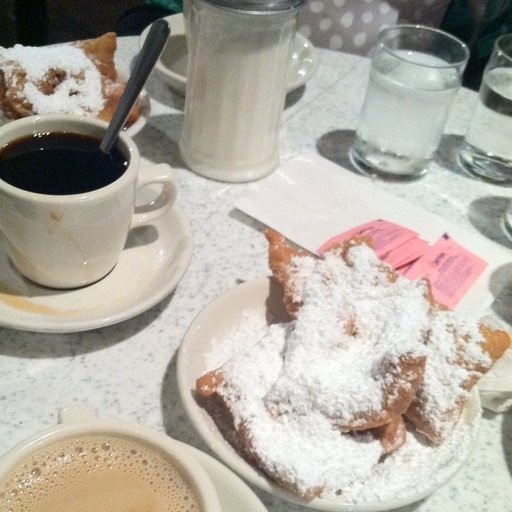

In [34]:
ds = load_dataset("food101", split="validation[:10]")
image = ds["image"][0]

image

In [35]:
# Simple function that takes
def predict_image(image):
  inputs = image_processor(image, return_tensors="pt")

  with torch.no_grad():
      logits = model(**inputs).logits

  predicted_label = logits.argmax(-1).item()
  return (model.config.id2label[predicted_label])


print(predict_image(image))

beignets


Lets try some of my own images. The first is a steak and the other is a cat (just to see what happens there)

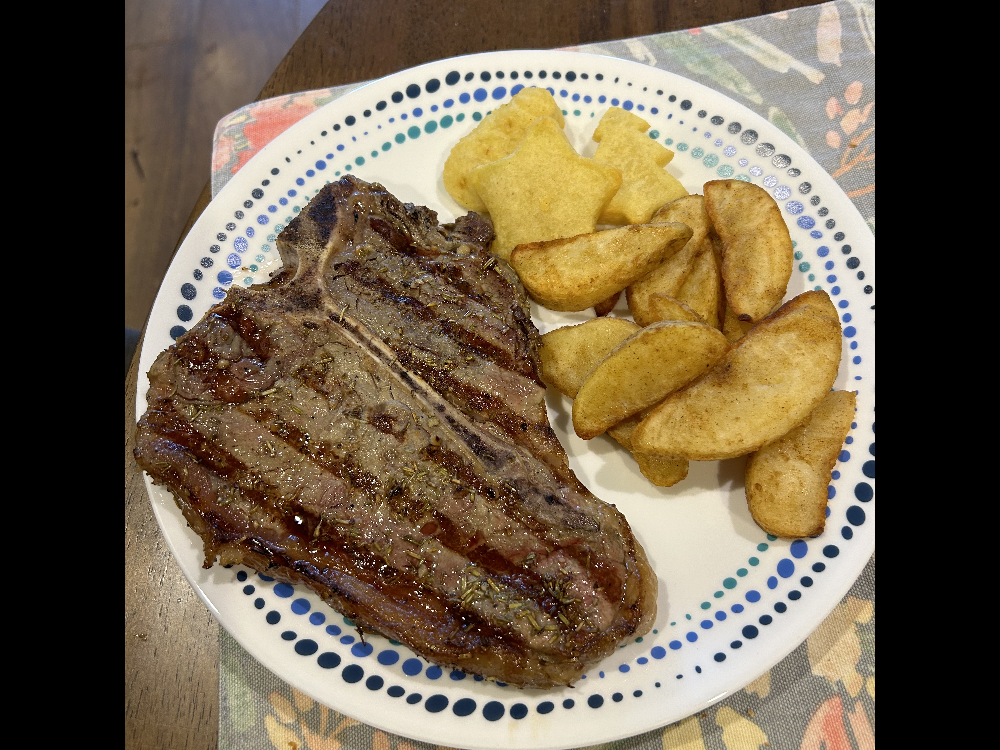

Model prediction: prime_rib


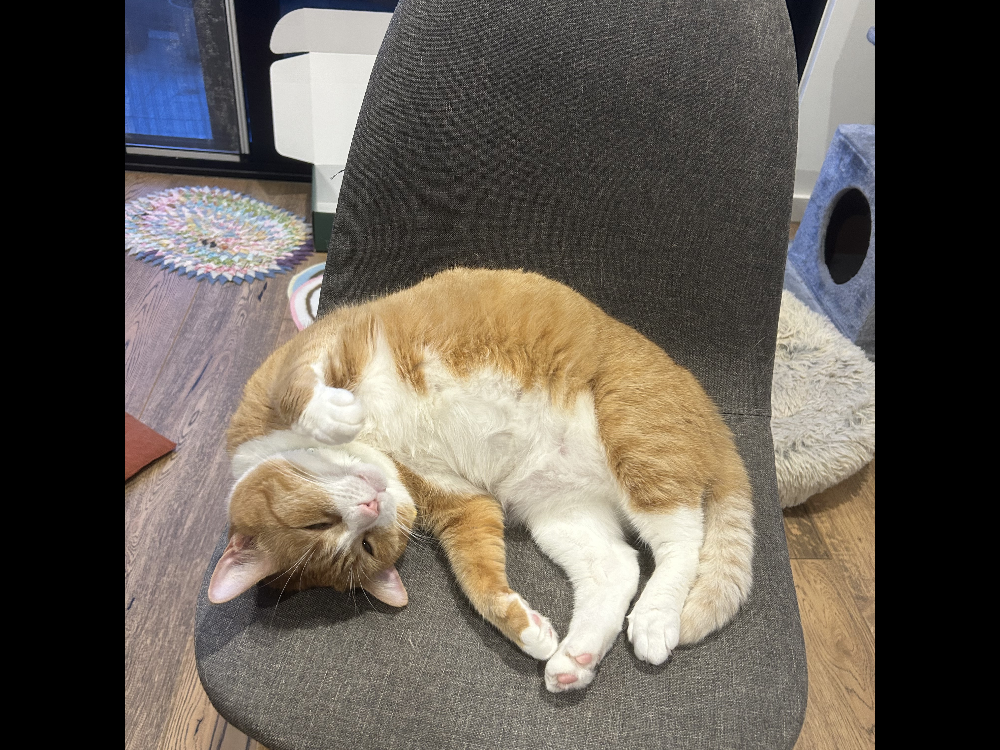

Model prediction: hamburger


In [60]:
from PIL import Image               # to load images
from IPython.display import display # to display images


image1 = Image.open('./images/IMG_4616.jpg').rotate(-90)
image2 = Image.open('./images/IMG_4216.jpg').rotate(-90)

display(image1)
print(f"Model prediction: {predict_image(image1)}")
display(image2)
print(f"Model prediction: {predict_image(image2)}")